&nbsp;
&nbsp;
&nbsp;

# **IMPORTACIONES**

In [1]:
import numpy as np

import pandas as pd

import os

import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras import regularizers

import matplotlib.pyplot as plt

import cv2

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

import sys

import gc

import time

import seaborn as sns

&nbsp;
&nbsp;
&nbsp;

# **SEMILLA**

In [2]:
SEED = 42                  #Semilla para garantizar la reproducibilidad del programa (asignada a parámetros random_state y seed)

&nbsp;
&nbsp;
&nbsp;

# **FUNCIONES**

In [3]:
# Carga y Ajuste del dataset de entrenamiento
def load_traindf():
    
    traindf = pd.read_csv('../input/landmark-recognition-2021/train.csv')
    
    #Añadir a train.csv la columna con la dirección de cada imagen para su posterior lectura
    traindf['img_path'] = (traindf['id'].apply(lambda r: os.path.join
                            ('../input/landmark-recognition-2021/train', r[0], r[1], r[2], r + '.jpg')))
    
    #Conversión de columna landmark_id de int64 a int32 para reducir consumo de memoria
    traindf['landmark_id'] = traindf['landmark_id'].apply(lambda x: np.int32(x))
    
    return traindf



# Lectura y Redimensionamiento imágenes a partir de su ruta (path)
def img_read_resize(img_path): 
    img = plt.imread(img_path)
    img_redim = cv2.resize(img,(IMG_SIZE,IMG_SIZE))
    return img_redim



# Obtener la memoria de cualquier objeto en Bytes
def get_size(obj, seen=None):
    """Recursively finds size of objects"""
    size = sys.getsizeof(obj)
    if seen is None:
        seen = set()
    obj_id = id(obj)
    if obj_id in seen:
        return 0
    # Important mark as seen *before* entering recursion to gracefully handle
    # self-referential objects
    seen.add(obj_id)
    if isinstance(obj, dict):
        size += sum([get_size(v, seen) for v in obj.values()])
        size += sum([get_size(k, seen) for k in obj.keys()])
    elif hasattr(obj, '__dict__'):
        size += get_size(obj.__dict__, seen)
    elif hasattr(obj, '__iter__') and not isinstance(obj, (str, bytes, bytearray)):
        size += sum([get_size(i, seen) for i in obj])
    return size

&nbsp;
&nbsp;
&nbsp;

# **DATASET DE ENTRENAMIENTO**

### Carga del dataset de entrenamiento

In [4]:
traindf = load_traindf()        #Función previamente definida para cargar el dataset ajustado

landmark_unique = len(traindf['landmark_id'].unique())    #Clases totales del dataset 

traindf

,id,landmark_id,img_path
0,17660ef415d37059,1,../input/landmark-recognition-2021/train/1/7/6...
1,92b6290d571448f6,1,../input/landmark-recognition-2021/train/9/2/b...
2,cd41bf948edc0340,1,../input/landmark-recognition-2021/train/c/d/4...
3,fb09f1e98c6d2f70,1,../input/landmark-recognition-2021/train/f/b/0...
4,25c9dfc7ea69838d,7,../input/landmark-recognition-2021/train/2/5/c...
...,...,...,...
1580465,72c3b1c367e3d559,203092,../input/landmark-recognition-2021/train/7/2/c...
1580466,7a6a2d9ea92684a6,203092,../input/landmark-recognition-2021/train/7/a/6...
1580467,9401fad4c497e1f9,203092,../input/landmark-recognition-2021/train/9/4/0...
1580468,aacc960c9a228b5f,203092,../input/landmark-recognition-2021/train/a/a/c...


In [5]:
sys.getsizeof(traindf)

317674630

In [6]:
get_size(traindf)

679611238

In [7]:
traindf.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1580470 entries, 0 to 1580469
Data columns (total 3 columns):
 #   Column       Non-Null Count    Dtype 
---  ------       --------------    ----- 
 0   id           1580470 non-null  object
 1   landmark_id  1580470 non-null  int32 
 2   img_path     1580470 non-null  object
dtypes: int32(1), object(2)
memory usage: 303.0 MB


### Información numérica del dataset de entrenamiento

In [8]:
print('Datos del dataset de entrenamiento original \n')
print('Número de imágenes en el dataset: ', traindf.shape[0])
print('Número de clases diferentes: ', landmark_unique)
print('Clase más baja: ', min(traindf['landmark_id']))
print('Clase más alta: ', max(traindf['landmark_id']))
print('\nRepeticiones de elementos por clase:')
print(traindf['landmark_id'].value_counts())

Datos del dataset de entrenamiento original 

Número de imágenes en el dataset:  1580470
Número de clases diferentes:  81313
Clase más baja:  1
Clase más alta:  203092

Repeticiones de elementos por clase:
138982    6272
126637    2231
20409     1758
83144     1741
113209    1135
          ... 
84677        2
36989        2
133688       2
17316        2
111405       2
Name: landmark_id, Length: 81313, dtype: int64


/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


(0.0, 6899.200000000001)

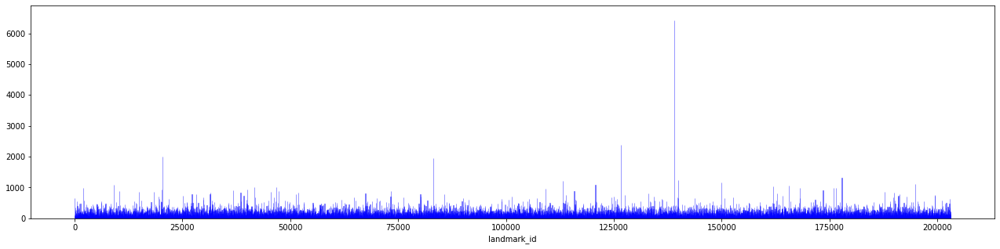

In [9]:
plt.figure(1, figsize = (22, 5))

sns.distplot(traindf['landmark_id'], hist=True, kde=False, 
             bins=int(landmark_unique/10), color = 'blue',
             hist_kws={'edgecolor':'blue'})

plt.ylim([0,1.1*max(traindf['landmark_id'].value_counts())])

> Se puede observar que el dataset no está balanceado **(Imbalanced Classification)** por la diferencia entre las frecuencias de las clases. Es necesario realizar oversampling o undersampling. En este programa se realizará **undersampling** en el dataset antes de realizar el split datos entrenamiento-validación, pues es más conveniente disminuir la cantidad de datos de las clases con mayor frecuencia para ahorrar memoria que aumentar los datos de las clases con poca frecuencia dada a la limitación de memoria del sistema. Si esta no fuera un problema, sería recomendable realizar el oversampling, obteniendo así una mayor precisión del modelo.

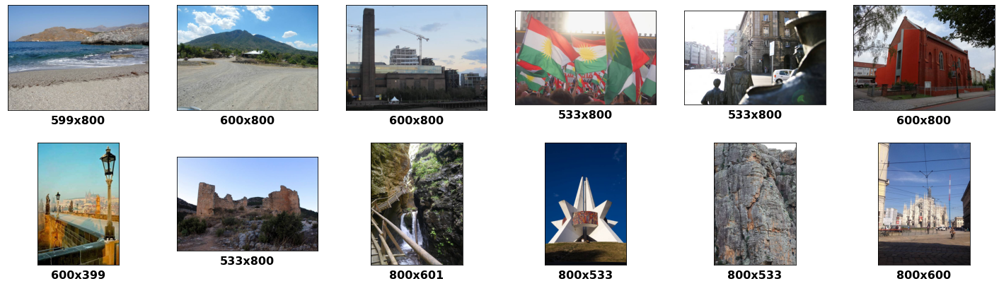

In [10]:
#Mostrar imágenes aleatorias del set de datos inicial

plt.figure(figsize=(25,7))

for i in range(12):
    j = np.random.randint(0, traindf.shape[0])        
    img = plt.imread((traindf['img_path'][j]))
    plt.subplot(2 , 6, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(str(img.shape[0])+'x'+str(img.shape[1]), 
               fontweight = "bold", fontsize=16)      #Resolución
    plt.imshow(img)
    
plt.show()

### Selección de una muestra y undersampling

In [11]:
'''
#SELECCIONAR MUESTRA SEGÚN NÚMERO DE DATOS (PROBLEMA: una muestra puede acabar en mitad de los datos de una clase; la clase estaría dividida en varias muestras)

IMG_SIZE = 160        #Tamaño/resolución de las imágenes que se empleará en todo el programa
N_DATOS = 10000       #Número de filas del dataframe tras undersampling que se usarán en la muestra

traindf_s = traindf_s.iloc[:N_DATOS,:]             #Muestra del dataset de entrenamiento tras undersampling

#Si se quieren barajar los datos :
#traindf.sample(frac=N_DATOS/traindf_unders.shape[0], random_state=SEED).reset_index(drop=True)  #Se obtiene un [frac %]  de filas del dataframe original y se barajan

'''

'\n#SELECCIONAR MUESTRA SEGÚN NÚMERO DE DATOS (PROBLEMA: una muestra puede acabar en mitad de los datos de una clase; la clase estaría dividida en varias muestras)\n\nIMG_SIZE = 160        #Tamaño/resolución de las imágenes que se empleará en todo el programa\nN_DATOS = 10000       #Número de filas del dataframe tras undersampling que se usarán en la muestra\n\ntraindf_s = traindf_s.iloc[:N_DATOS,:]             #Muestra del dataset de entrenamiento tras undersampling\n\n#Si se quieren barajar los datos :\n#traindf.sample(frac=N_DATOS/traindf_unders.shape[0], random_state=SEED).reset_index(drop=True)  #Se obtiene un [frac %]  de filas del dataframe original y se barajan\n\n'

In [12]:
#SELECCIONAR MUESTRA SEGÚN CLASES MAX Y MIN (TODOS LOS DATOS COMPRENDIDOS ENTRE DICHAS CLASES Y DE DICHAS CLASES)

IMG_SIZE = 128       #Tamaño/resolución de las imágenes que se empleará en todo el programa

#MUESTRA
CLASE_MIN = 0
CLASE_MAX = 1500

#Obtención de muestra traindf_s
traindf_s = traindf[(CLASE_MIN<traindf['landmark_id']) & (traindf['landmark_id']<=CLASE_MAX)]


UMBRAL_UNDERSAMPLING = 80   

#Undersampling en la muestra
traindf_s = (traindf_s.groupby('landmark_id', group_keys=False).
           apply(lambda x: x.sample(n = min(len(x), UMBRAL_UNDERSAMPLING), random_state= SEED)))
traindf_s.reset_index(inplace=True, drop=True)  #Reiniciar índices. drop=True índices antiguos no sean nueva columna
traindf_s['landmark_id'].value_counts()            #Frecuencias de las clases tras undersampling

#--------------------------------------------------------------------------------------------------------------------------------------------------------#
N_DATOS = len(traindf_s['landmark_id'])
clases = traindf_s['landmark_id'].unique()
N_CLASES = len(clases)

print('Número de datos de la muestra, N_DATOS: '+str(N_DATOS))
print('\nNúmero de clases de la muestra, N_CLASES: '+str(N_CLASES))
print('\nClase más baja de la muestra: '+str(min(traindf_s['landmark_id'])))
print('\nClase más alta de la muestra: '+str(max(traindf_s['landmark_id'])))
print('\nRepeticiones de elementos por clase en la muestra tras Undersampling:')
print(traindf_s['landmark_id'].value_counts())

Número de datos de la muestra, N_DATOS: 9958

Número de clases de la muestra, N_CLASES: 594

Clase más baja de la muestra: 1

Clase más alta de la muestra: 1497

Repeticiones de elementos por clase en la muestra tras Undersampling:
578     80
870     80
1189    80
136     80
145     80
        ..
991      2
240      2
997      2
215      2
611      2
Name: landmark_id, Length: 594, dtype: int64


In [13]:
clases

array([   1,    7,    9,   11,   12,   17,   22,   23,   24,   27,   29,
         30,   32,   34,   36,   37,   41,   43,   48,   50,   51,   56,
         58,   60,   63,   65,   66,   72,   79,   81,   82,   83,   84,
         87,   89,   90,   99,  100,  101,  103,  104,  110,  111,  115,
        117,  118,  123,  124,  131,  134,  135,  136,  139,  141,  143,
        145,  146,  149,  151,  155,  166,  168,  172,  173,  174,  175,
        177,  178,  183,  185,  187,  189,  191,  192,  199,  202,  209,
        212,  213,  215,  216,  219,  221,  223,  225,  226,  228,  230,
        232,  240,  242,  243,  244,  245,  247,  250,  259,  260,  262,
        263,  264,  270,  272,  274,  277,  278,  283,  285,  287,  289,
        294,  297,  300,  304,  309,  310,  316,  318,  320,  324,  327,
        331,  332,  333,  337,  341,  343,  344,  347,  350,  352,  353,
        354,  355,  356,  357,  361,  363,  366,  374,  375,  379,  380,
        385,  386,  389,  390,  392,  393,  394,  3

In [14]:
traindf_s

,id,landmark_id,img_path
0,92b6290d571448f6,1,../input/landmark-recognition-2021/train/9/2/b...
1,fb09f1e98c6d2f70,1,../input/landmark-recognition-2021/train/f/b/0...
2,17660ef415d37059,1,../input/landmark-recognition-2021/train/1/7/6...
3,cd41bf948edc0340,1,../input/landmark-recognition-2021/train/c/d/4...
4,28b13f94a6f1f3c1,7,../input/landmark-recognition-2021/train/2/8/b...
...,...,...,...
9953,53d683c8fff894dd,1497,../input/landmark-recognition-2021/train/5/3/d...
9954,d6ce7313aca05ba3,1497,../input/landmark-recognition-2021/train/d/6/c...
9955,5d988143cfa7873d,1497,../input/landmark-recognition-2021/train/5/d/9...
9956,52938c1e34fe4a05,1497,../input/landmark-recognition-2021/train/5/2/9...


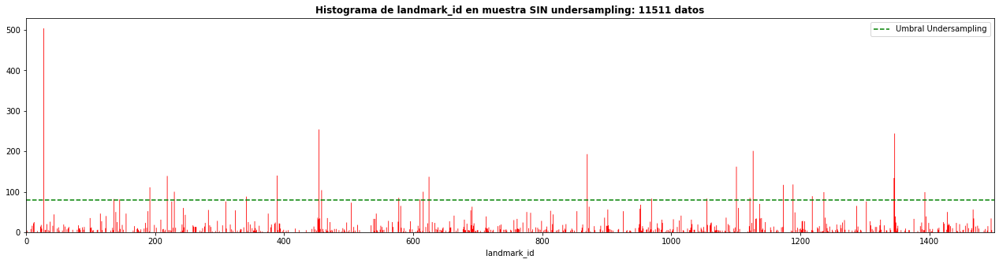

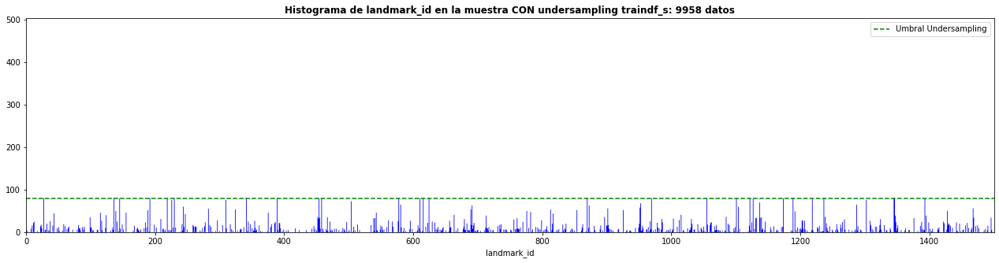

In [15]:
#Comparación de datos en el mismo intervalo de clases [CLASE_MIN, CLASE_MAX]

# Muestra del dataset SIN undersampling
traindf_no_unders = traindf[(CLASE_MIN<traindf['landmark_id']) & (traindf['landmark_id']<=CLASE_MAX)]
plt.figure(1, figsize = (22, 5))
plt.title('Histograma de landmark_id en muestra SIN undersampling: '+ str(len(traindf_no_unders))+' datos', fontweight ="bold")
plt.hist(traindf_no_unders['landmark_id'], color = 'red', bins= CLASE_MAX - CLASE_MIN+1, histtype= 'stepfilled')
plt.xlabel('landmark_id')
plt.xlim([0,CLASE_MAX])
plt.axhline(y=UMBRAL_UNDERSAMPLING, color='g', linestyle='--', label= 'Umbral Undersampling')      #Línea horizontal indicando umbral
plt.legend()
plt.show()


# Muestra del dataset CON undersampling
plt.figure(2, figsize = (22, 5))
plt.title('Histograma de landmark_id en la muestra CON undersampling traindf_s: '+ str(N_DATOS)+' datos', fontweight = "bold")
plt.hist(traindf_s['landmark_id'], color = 'blue', bins = CLASE_MAX - CLASE_MIN+1, histtype= 'stepfilled')
plt.xlabel('landmark_id')
plt.xlim([0,CLASE_MAX])
plt.ylim([0,max(traindf_no_unders['landmark_id'].value_counts())])
plt.axhline(y=UMBRAL_UNDERSAMPLING, color='g', linestyle='--', label= 'Umbral Undersampling')      #Línea horizontal indicando umbral
plt.legend()
plt.show()

> Se ha conseguido equilibrar en cierta medida las frecuencias de las clases a costa de disminuir los datos.

In [16]:
traindf_s['landmark_id'].value_counts().describe()

count    594.000000
mean      16.764310
std       19.446775
min        2.000000
25%        5.000000
50%        9.000000
75%       20.000000
max       80.000000
Name: landmark_id, dtype: float64

In [17]:
#Eliminar de memoria el dataset completo sin imágenes; solo se usará la muestra
print('ELIMINANDO ' + str(round((get_size(traindf)/(1024*1024)),4)) +' MB ocupados por traindf')
del traindf          #Elimina la relación entre la variable y el espacio de memoria al que apunta
gc.collect();        #Elimina de memoria y devuelve los objetos a los que ya no se apunta

ELIMINANDO 720.4772 MB ocupados por traindf


In [18]:
print('ELIMINANDO ' + str(round((get_size(traindf_no_unders)/(1024*1024)),4)) +' MB ocupados por traindf_no_unders (muestra sin undersampling)')
del traindf_no_unders         #Elimina la relación entre la variable y el espacio de memoria al que apunta
gc.collect();                 #Elimina de memoria y devuelve los objetos a los que ya no se apunta

ELIMINANDO 5.3001 MB ocupados por traindf_no_unders (muestra sin undersampling)


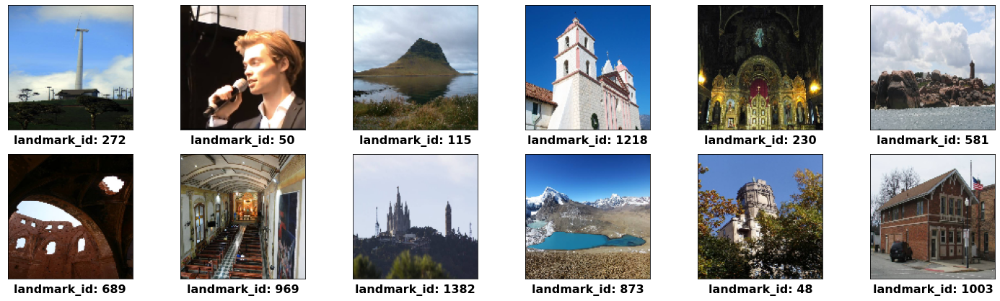

In [19]:
#Mostrar imágenes aleatorias de la muestra

plt.figure(figsize=(25,7))

for i in range(12):
    j = np.random.randint(0, N_DATOS)              #Cambiar j por i en las indexaciones si se quieren imágenes aleatorias de la muestra
    img = img_read_resize(traindf_s['img_path'][j])     #Para que las imágenes tengan el mismo tamaño (= número de píxeles = neuronas de entrada)
    plt.subplot(2 , 6, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('landmark_id: '+ str(traindf_s['landmark_id'][j]), fontweight ="bold", fontsize=16)
    plt.imshow(img)
    
plt.show()

### Redimensionamiento de las imágenes del dataset de entrenamiento. Almacenamiento de las imágenes en una variable y de las etiquetas en otra

In [20]:
X = []   #Imágenes
y = []   #Clases

for i in range(traindf_s.shape[0]):   
    X.append(img_read_resize(traindf_s['img_path'][i])) 
    y.append(np.array(traindf_s['landmark_id'][i]))            #Cada etiqueta se convierte en numpy.ndarray (por compatibilidad con las imágenes en X, que son ndarrays)

print('Tipos de las variables: \n')
print('X: ', type(X))
print('Elementos de X: ', type(X[0]))
print('\ny: ', type(y))
print('Elementos de y: ', type(y[0]))

Tipos de las variables: 

X:  <class 'list'>
Elementos de X:  <class 'numpy.ndarray'>

y:  <class 'list'>
Elementos de y:  <class 'numpy.ndarray'>


### Label Encoding Etiquetas

In [21]:
#Label Encoding

LE = LabelEncoder()
LE.fit(clases)
y_LE = LE.transform(y)

In [22]:
print(clases)

[   1    7    9   11   12   17   22   23   24   27   29   30   32   34
   36   37   41   43   48   50   51   56   58   60   63   65   66   72
   79   81   82   83   84   87   89   90   99  100  101  103  104  110
  111  115  117  118  123  124  131  134  135  136  139  141  143  145
  146  149  151  155  166  168  172  173  174  175  177  178  183  185
  187  189  191  192  199  202  209  212  213  215  216  219  221  223
  225  226  228  230  232  240  242  243  244  245  247  250  259  260
  262  263  264  270  272  274  277  278  283  285  287  289  294  297
  300  304  309  310  316  318  320  324  327  331  332  333  337  341
  343  344  347  350  352  353  354  355  356  357  361  363  366  374
  375  379  380  385  386  389  390  392  393  394  397  399  403  406
  417  423  434  443  446  448  450  452  453  454  455  456  458  460
  461  465  466  467  468  471  472  474  475  478  481  485  489  491
  493  494  497  499  501  504  507  508  510  514  517  535  539  540
  541 

In [23]:
###print('ELIMINANDO ' + str(get_size(df_train)/(1024*1024)) +' MB ocupados por df_train')
###del df_train         #Elimina la relación entre la variable y la memoria a la que apunta
###gc.collect();        #Elimina de memoria y devuelve los objetos a los que ya no se apunta

In [24]:
print('ELIMINANDO ' + str(round((get_size(traindf_s)/(1024*1024)),4)) +' MB ocupados por traindf_s')
del traindf_s         #Elimina la relación entre la variable y la memoria a la que apunta
gc.collect();         #Elimina de memoria y devuelve los objetos a los que ya no se apunta

ELIMINANDO 4.0924 MB ocupados por traindf_s


In [25]:
whos

Variable               Type            Data/Info
------------------------------------------------
CLASE_MAX              int             1500
CLASE_MIN              int             0
EarlyStopping          type            <class 'keras.callbacks.EarlyStopping'>
IMG_SIZE               int             128
LE                     LabelEncoder    LabelEncoder()
LabelEncoder           type            <class 'sklearn.preproces<...>ing._label.LabelEncoder'>
ModelCheckpoint        type            <class 'keras.callbacks.ModelCheckpoint'>
N_CLASES               int             594
N_DATOS                int             9958
ReduceLROnPlateau      type            <class 'keras.callbacks.ReduceLROnPlateau'>
SEED                   int             42
UMBRAL_UNDERSAMPLING   int             80
X                      list            n=9958
clases                 ndarray         594: 594 elems, type `int32`, 2376 bytes
confusion_matrix       function        <function confusion_matrix at 0x7f36f80e1f80>


### Ajustes a las variables

#Conversión de lista X a array + Normalización de las imágenes en X + Cambio de tipo de int8 a float16 para reducir memoria
X = np.array(X).astype('float16')/255     #Se normalizan las imágenes para que los valores de los píxeles estén entre [0,1] en vez de [0,255]

#Conversión de lista y a array
y = np.array(y)

### Obtención de los datos de validación y testeo

In [26]:
###### X = [n/255 for n in X]       #Escalado de los datos ---> DISMINUYE PRECISIÓN

X = np.array(X)    #Conversión de lista a array necesaria
y_LE = np.array(y_LE)
y = np.array(y)

In [27]:
#Separación de los datos en datos para entrenamiento, datos para validación y datos de testeo

#Validación
X_train, X_val, y_train, y_val = train_test_split(X, y_LE, test_size = 0.10, random_state=SEED, shuffle=True)
        #Mismo tipo que X e y (ndarray formado por ndarrays o int64, respectivamente)

#Testeo
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size = 0.05, random_state=SEED, shuffle=True)

n_datos_entrenamiento = len(X_train)

print('Imágenes en X: ',len(X), ' y etiquetas en y: ', len(y_LE))
print('Entrenamiento. Imágenes en X_train: ',len(X_train), 'y etiquetas en y_train: ',len(y_train))
print('Validación. Imágenes en X_val: ',len(X_val), 'y etiquetas en y_val: ',len(y_val))
print('Testeo. Imágenes en X_test: ',len(X_test), 'y etiquetas en y_test: ',len(y_test))

Imágenes en X:  9958  y etiquetas en y:  9958
Entrenamiento. Imágenes en X_train:  8513 y etiquetas en y_train:  8513
Validación. Imágenes en X_val:  996 y etiquetas en y_val:  996
Testeo. Imágenes en X_test:  449 y etiquetas en y_test:  449


In [28]:
from keras.applications.resnet import preprocess_input

X_train = preprocess_input(X_train)
X_val = preprocess_input(X_val)
X_test_orig = X_test                                     #Para representar al final las img testeo sin procesado
X_test = preprocess_input(X_test)

In [29]:
X_train.shape

(8513, 128, 128, 3)

In [30]:
type(X)

numpy.ndarray

2022-08-24 21:18:31.020849: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-08-24 21:18:31.143460: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-08-24 21:18:31.144330: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-08-24 21:18:31.147158: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

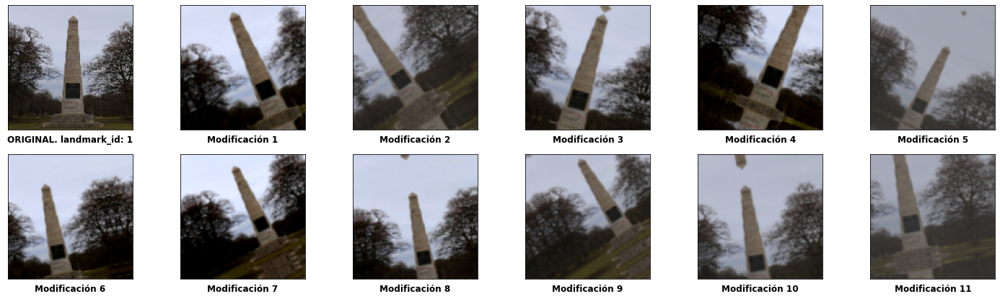

In [31]:
data_augmentation = tf.keras.Sequential([
    #preprocessing.RandomFlip('horizontal'),
    preprocessing.RandomZoom(height_factor=(-0.2, 0.2)),
    preprocessing.RandomContrast(0.4),
    preprocessing.RandomTranslation(height_factor= (-0.2, 0.2), width_factor=(-0.2, 0.2)), 
    preprocessing.RandomRotation(factor= (-0.1, 0.1)),     #Giros entre -10%*2*pi y 10%*2*pi        
    #preprocessing.RandomCrop(120, 120, seed=SEED)
])

#Se representa una imagen original de la muestra junto a algunas de sus posibles modificaciones
plt.figure(figsize=(25,7))
j = 1 #np.random.randint(0, N_DATOS)
img_orig = X[j]
plt.subplot(2 , 6, 1)
plt.xticks([])
plt.yticks([])
plt.xlabel('ORIGINAL. landmark_id: '+ str(y[j]), fontweight ="bold", fontsize=12)
plt.imshow(img_orig)

for i in range(11):
    img_mod = data_augmentation(img_orig)
    plt.subplot(2 , 6, i+2)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('Modificación '+str(i+1), fontweight ="bold", fontsize=12)
    plt.imshow(img_mod)
    
plt.show()

In [32]:
np.shape(y_train)

(8513,)

In [33]:
np.shape(X_train)

(8513, 128, 128, 3)

### OVERSAMPLING de datos de entrenamiento

In [34]:
N_CLASES

594

In [35]:
start_time = time.time()

UMBRAL_OVERSAMPLING = 0.2 * UMBRAL_UNDERSAMPLING       #PORCENTAJE DEL UMBRAL_UNDERSAMPLING HASTA EL QUE SE AUMENTA
i=0; n=0; k=0

for i in range(N_CLASES):     #Número de clases únicas
    cont=0
    for n in range(len(y_train)):
        if y_train[n] == i:
            cont = cont+1
                  
    if cont < UMBRAL_OVERSAMPLING:
        img_clase_i = X_train[y_train==i]
        for k in range(int(UMBRAL_OVERSAMPLING-cont)):
            X_train = np.concatenate((X_train,np.array([(img_clase_i[np.random.randint(len(img_clase_i))])])),axis = 0)
            y_train = np.append(y_train, i)

print('\nDuración del oversampling: %s segundos' % (time.time() - start_time))
n_datos_train_def = len(X_train)
print('\nDatos de entrenamiento tras oversampling: '+str(n_datos_train_def)+' datos')
print('\nLos datos de entrenamiento han pasado de: '+str(n_datos_entrenamiento)+' a:'+ str(n_datos_train_def))


Duración del oversampling: 3220.686148405075 segundos

Datos de entrenamiento tras oversampling: 12724 datos

Los datos de entrenamiento han pasado de: 8513 a:12724


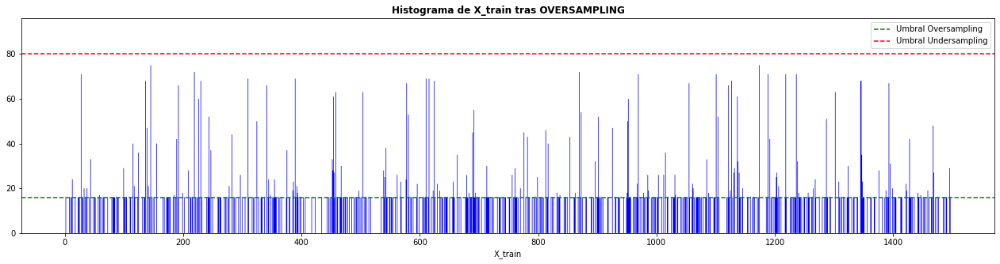

In [36]:
# X_train con oversampling
plt.figure(2, figsize = (22, 5))
plt.title('Histograma de X_train tras OVERSAMPLING', fontweight = "bold")
plt.hist(LE.inverse_transform(y_train), color = 'blue', bins = CLASE_MAX - CLASE_MIN+1, histtype= 'stepfilled')
plt.xlabel('X_train')
plt.ylim([0,1.2*UMBRAL_UNDERSAMPLING])
plt.axhline(y=UMBRAL_OVERSAMPLING, color='g', linestyle='--', label= 'Umbral Oversampling')      #Línea horizontal indicando umbral Oversampling
plt.axhline(y=UMBRAL_UNDERSAMPLING, color='r', linestyle='--', label= 'Umbral Undersampling')      #Línea horizontal indicando umbral Undersampling
plt.legend()
plt.show()

In [37]:
print('ELIMINANDO ' + str(round((get_size(X)/(1024*1024)),4)) +' MB ocupados por X')
del X         #Elimina la relación entre la variable y la memoria a la que apunta
gc.collect();        #Elimina de memoria y devuelve los objetos a los que ya no se apunta

ELIMINANDO 466.7822 MB ocupados por X


In [38]:
print('ELIMINANDO ' + str(round((get_size(y_LE)/(1024*1024)),4)) +' MB ocupados por y_LE')
del y_LE        #Elimina la relación entre la variable y la memoria a la que apunta
gc.collect();       #Elimina de memoria y devuelve los objetos a los que ya no se apunta

ELIMINANDO 0.38 MB ocupados por y_LE


In [39]:
print('ELIMINANDO ' + str(round((get_size(y)/(1024*1024)),4)) +' MB ocupados por y')
del y        #Elimina la relación entre la variable y la memoria a la que apunta
gc.collect();       #Elimina de memoria y devuelve los objetos a los que ya no se apunta

ELIMINANDO 0.304 MB ocupados por y


&nbsp;
&nbsp;
&nbsp;

# **HIPERPARÁMETROS DEL MODELO**

In [40]:
#Hiperparámetros de la red neuronal convolucional

kernelSize = (3,3)        #Tamaño de la plantilla de convolución
paddingType = 'same'      #Cómo se procede en los bordes de las imágenes ('same' o 'valid')
activationF = 'relu'      #Función de activación
poolSize = (2,2)          #Tamaño de la plantilla de maximum pooling
stridesSize = (2,2)       #Desplazamiento de plantilla durante maximum pooling
dropoutRate = 0.5         #Porcentaje de neuronas que se desactivan con la capa Dropout
batchSize = 256           #Cantidad de datos con los que se entrena en cada época
epochsSize= 2000          #Número de épocas en las que se entrena
lr = 0.01                 #Learning Rate
weightDecay = regularizers.L2(0.01) #Regularización de pesos ---> L1: Suma pesos absolutos. 
                          #L2: Suma pesos cuadrados. L1L2: Suma pesos absolutos y cuadrados

&nbsp;
&nbsp;
&nbsp;

# **FUNCIÓN PARA CREACIÓN, COMPILACIÓN Y ENTRENAMIENTO DEL MODELO**

In [41]:
def crear_modelo():
    
    ResNet50 = (keras.applications.ResNet50(include_top=False, 
                weights='imagenet', input_shape=([IMG_SIZE, IMG_SIZE, 3])))
    
    ResNet50.trainable=False
        
    model = keras.Sequential()
    
    model.add(preprocessing.RandomZoom(height_factor=(-0.2, 0.2)))
    model.add(preprocessing.RandomContrast(0.4))
    model.add(preprocessing.RandomTranslation(height_factor= (-0.2, 0.2), width_factor=(-0.2, 0.2))) 
    model.add(preprocessing.RandomRotation(factor= (-0.1, 0.1)))
    
    model.add(ResNet50)
                 
    model.add(layers.Flatten())
    model.add(layers.Dense(units = 512, activation=activationF, kernel_regularizer=weightDecay))
    model.add(layers.Dropout(rate=dropoutRate,seed=SEED))
    model.add(layers.BatchNormalization())
    model.add(layers.Dense(units = 512, activation=activationF, kernel_regularizer=weightDecay))
    model.add(layers.Dropout(rate=dropoutRate,seed=SEED))
    model.add(layers.BatchNormalization())
    model.add(layers.Dense(units = N_CLASES, activation='softmax'))
    
    
    #OPTIMIZADORES
    # A menor lr, menos cambios repentinos hay en las métricas como acuracy
    opt1 = tf.keras.optimizers.RMSprop(learning_rate=lr, rho=0.9, momentum=0.5, epsilon=1e-07)   
    opt2 = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
    opt3 = tf.keras.optimizers.SGD(learning_rate=lr, momentum=0.9, nesterov=False)                 #momentum--> acelera gradiente y amortigua oscilaciones
    
    #Compilación del modelo   
    model.compile(
        optimizer = opt3,
        loss = 'sparse_categorical_crossentropy',
        metrics = ['sparse_categorical_accuracy']
    )
    
    #Callback 1
    early_stopping = EarlyStopping(
        monitor = "val_loss",
        mode = "auto",
        min_delta = 0.0001,         # minimium amount of change to count as an improvement
        patience = 150,              # how many epochs to wait before stopping
        restore_best_weights = True)
    
    #Callback 2
    reduce_lr = ReduceLROnPlateau(
        monitor='val_loss', factor=0.7, 
        patience=40, cooldown=1, min_lr=0.0005,
        min_delta=0.001, verbose=1)
    
    #Callback 3
    checkpoint = ModelCheckpoint(
        'best-weights.h5', monitor='val_loss', 
        save_best_only=True, save_weights_only=True)
    
    
    #Entrenamiento del modelo
    history = model.fit(
        X_train, y_train,
        validation_data = (X_val, y_val),      #LAS ESTIQUETAS ESTÁN con CODIFICACIÓN LABEL ENCODING
        class_weight = dic_class_weights,      #Para solucionar Imbalanced Data (similar a Oversampling)
        shuffle = True,                        #Solo afecta a los datos de entrenamiento (1 vez al principio)
        batch_size = batchSize,
        steps_per_epoch = len(X_train)//batchSize,
        epochs = epochsSize,
        callbacks = [early_stopping, reduce_lr, checkpoint],
        verbose=1,            # 0: silencio     1: barra de progreso + texto      2: solo texto
        #use_multiprocessing=True,
        #max_queue_size = 15,        #Default = 10
        #workers = 32,
    ) 
  
    return model, history

&nbsp;
&nbsp;
&nbsp;

# **GRÁFICAS DE PÉRDIDA Y PRECISIÓN Y EVALUACIÓN DEL MODELO**

In [42]:
# Cálculo de pesos de cada clase de los datos para entrenamiento de la muestra
_, freq = np.unique(y_train, return_counts=True)
max_freq = np.max(freq)
print ('Mayor frecuencia: '+str(np.max(freq)))

##Método no funciona correctamente con este set debido a la numeración de landmark_id
##from sklearn.utils import class_weight
##classWeights = class_weight.compute_class_weight(class_weight ='balanced',classes = np.unique(y_train), y = y_train)
##train_classWeights = dict(enumerate(classWeights))

#Se realiza este procedimiento porque con el método compute_class_weight no funciona --> Las keys del diccionario deben coincidir con las etiquetas
dic_class_weights ={}
i=0
for i in range(max(y_train)+1):                   #Se va a crear un diccionario de max(y_train)+1 elementos, aunque el número de clases sea menor
    dic_class_weights[i] = 0                      #Inicialmente todos los pesos (valores del diccionario) a 0
    if i in y_train:                              #Si la clave coincide con el landmark_id (etiqueta) el peso no será 0
        freq = len(y_train[y_train == i])          #Frecuencia de la etiqueta i
        dic_class_weights[i] = max_freq/freq

Mayor frecuencia: 75


94781440/94765736 [==============================] - 0s 0us/step


2022-08-24 22:12:19.826867: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 2501640192 exceeds 10% of free system memory.
2022-08-24 22:12:22.579575: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 2501640192 exceeds 10% of free system memory.
2022-08-24 22:12:24.647532: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/2000


2022-08-24 22:12:30.060696: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


49/49 [==============================] - 23s 234ms/step - loss: 37.6546 - sparse_categorical_accuracy: 0.0109 - val_loss: 20.6147 - val_sparse_categorical_accuracy: 0.0311
Epoch 2/2000
49/49 [==============================] - 9s 183ms/step - loss: 32.6222 - sparse_categorical_accuracy: 0.0720 - val_loss: 18.1125 - val_sparse_categorical_accuracy: 0.0783
Epoch 3/2000
49/49 [==============================] - 9s 182ms/step - loss: 27.9661 - sparse_categorical_accuracy: 0.1496 - val_loss: 15.9422 - val_sparse_categorical_accuracy: 0.1476
Epoch 4/2000
49/49 [==============================] - 9s 184ms/step - loss: 24.4271 - sparse_categorical_accuracy: 0.2132 - val_loss: 14.3238 - val_sparse_categorical_accuracy: 0.1988
Epoch 5/2000
49/49 [==============================] - 9s 184ms/step - loss: 21.4611 - sparse_categorical_accuracy: 0.2726 - val_loss: 12.9062 - val_sparse_categorical_accuracy: 0.2590
Epoch 6/2000
49/49 [==============================] - 9s 184ms/step - loss: 19.2294 - sparse

2022-08-25 02:23:50.721148: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 2501640192 exceeds 10% of free system memory.
2022-08-25 02:23:53.636058: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 2501640192 exceeds 10% of free system memory.


398/398 [==============================] - 11s 28ms/step - loss: 1.1797 - sparse_categorical_accuracy: 0.9608
Test loss, Test accuracy: 1.1797130107879639 0.9607827663421631

Evaluación del modelo con datos de validación
32/32 [==============================] - 1s 31ms/step - loss: 2.8597 - sparse_categorical_accuracy: 0.6376
Test loss, Test accuracy: 2.8596794605255127 0.6375501751899719


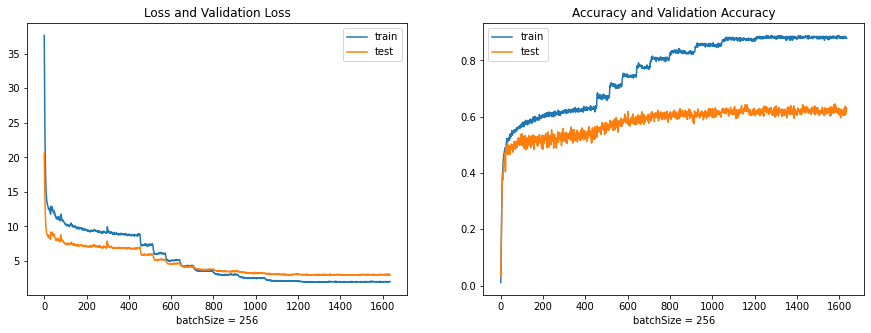


Duración del entrenamiento: 252.00480595429738 minutos


In [43]:
start_time = time.time()

model, history = crear_modelo()
    
history_df = pd.DataFrame(history.history)    
    
print('\nbatchSize = '+str(batchSize))
    
plt.figure(figsize=(15,5))        #Anchura y Altura de las gráficas, respectivamente
    
plt.subplot(1,2,1)
#history_df.loc[0:, ['loss', 'val_loss']].plot()             #Utilizar dataframe y su método plot dan problemas con plt.subplot
plt.plot(history.history['loss'], label='train')        
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.title('Loss and Validation Loss')
plt.xlabel('batchSize = '+str(batchSize))
print(("Minimum Validation Loss: {:0.4f} in epoch {:0.0f} ").format(history_df['val_loss'].min(), history_df['val_loss'].idxmin()))            
    
plt.subplot(1,2,2)
#history_df.loc[0:, ['accuracy', 'val_accuracy']].plot()
plt.plot(history.history['sparse_categorical_accuracy'], label='train')
plt.plot(history.history['val_sparse_categorical_accuracy'], label='test')
plt.legend()
plt.title('Accuracy and Validation Accuracy')
plt.xlabel('batchSize = '+str(batchSize))
print(("Maximum Validation Accuracy: {:0.4f} in epoch {:0.0f} ").format(history_df['val_sparse_categorical_accuracy'].max(), history_df['val_sparse_categorical_accuracy'].idxmax()))

print("\nEvaluación del modelo con datos de entrenamiento")
score = model.evaluate(X_train, y_train)
print("Test loss, Test accuracy:", score[0], score[1])

print("\nEvaluación del modelo con datos de validación")
score = model.evaluate(X_val, y_val)
print("Test loss, Test accuracy:", score[0], score[1])

plt.show()    #Se muestran las gráficas
    
print('\nDuración del entrenamiento: %s minutos' % ((time.time() - start_time)/60))

In [44]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
random_zoom_1 (RandomZoom)   (None, 128, 128, 3)       0         
_________________________________________________________________
random_contrast_1 (RandomCon (None, 128, 128, 3)       0         
_________________________________________________________________
random_translation_1 (Random (None, 128, 128, 3)       0         
_________________________________________________________________
random_rotation_1 (RandomRot (None, 128, 128, 3)       0         
_________________________________________________________________
resnet50 (Functional)        (None, 4, 4, 2048)        23587712  
_________________________________________________________________
flatten (Flatten)            (None, 32768)             0         
_________________________________________________________________
dense (Dense)                (None, 512)              

### Cargar al modelo los mejores pesos (según val_loss)

In [45]:
model.load_weights('best-weights.h5')
print('Mejores pesos cargados al modelo')

Mejores pesos cargados al modelo


In [46]:
#model.get_weights()

In [47]:
#Guardado del modelo completo

#-------model.save('./MyModel_h5',save_format='h5')  
#model.save('./MyModel_tf',save_format='tf')

#Guardado de pesos del modelo
#-----model.save_weights('./Model_Weights_h5', save_format='h5')

In [48]:
#Cargado de un modelo guardado

#---model_cargado = tf.keras.models.load_model('./MyModel_h5')

In [49]:
'''
#En caso de que sea necesario borrar algún archivo en el directorio de salida

filename = ''
import os
os.remove(filename)
'''

"\n#En caso de que sea necesario borrar algún archivo en el directorio de salida\n\nfilename = ''\nimport os\nos.remove(filename)\n"

In [50]:
'''
#En caso de que sea necesario borrar algún directorio en el directorio de salida
directory = ''
import shutil
shutil.rmtree(directory)
'''

"\n#En caso de que sea necesario borrar algún directorio en el directorio de salida\ndirectory = ''\nimport shutil\nshutil.rmtree(directory)\n"

#Reentrenar el modelo

model_cargado.fit(
        X_train, y_train,
        validation_data= (X_val, y_val),
        shuffle = True,
        batch_size=batchSize,
        epochs=epochsSize,
        callbacks=[early_stopping],
        verbose=1,    # 0: silencio     1: barra de progreso + texto      2: solo texto)
)

&nbsp;
&nbsp;
&nbsp;

# **PREDICCIÓN DE LOS DATOS DE TESTEO DEL SPLIT**

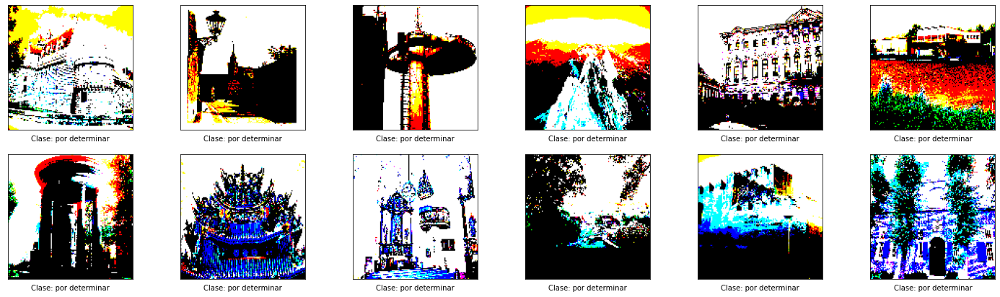

In [51]:
plt.figure(figsize=(25,7))

for i in range(12):  
    img = X_test[i]  #Ya se hizo el shuffle con el split
    plt.subplot(2 , 6, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('Clase: por determinar')
    plt.imshow(img)

In [52]:
np.shape(X_test)

(449, 128, 128, 3)

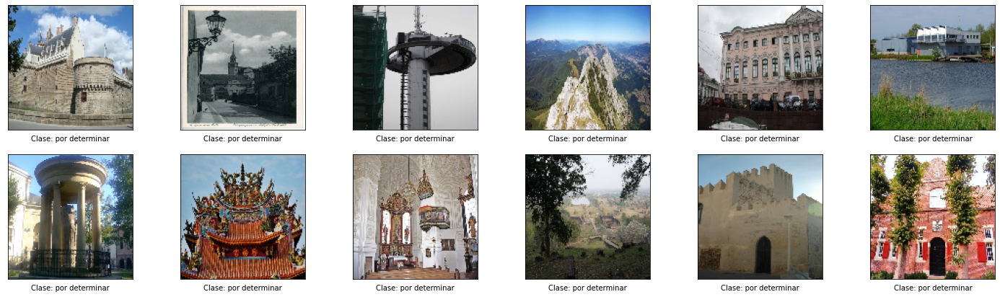

In [53]:
plt.figure(figsize=(25,7))

for i in range(12):  
    img = X_test_orig[i]  #Ya se hizo el shuffle con el split
    plt.subplot(2 , 6, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('Clase: por determinar')
    plt.imshow(img)

In [54]:
predic = model.predict(X_test, verbose=1)       # batch_size=None,        #Se realiza la predicción

15/15 [==============================] - 1s 30ms/step


In [55]:
y_pred = []
confianza = []

for i in range(len(predic)):
    y_pred.append(np.argmax(predic[i]))                 #Clase (landmark_id) con mayor probabilidad
    confianza.append(predic[i][y_pred[i]].round(2))                            #Probabilidad de la clase con mayor probabilidad
    
y_pred = LE.inverse_transform(y_pred)
y_pred

array([ 813, 1101, 1287,  278, 1137,  862, 1376, 1265, 1422,  354,  283,
        776, 1015,  543, 1430, 1204,  155,  389,  341,  689,  643, 1289,
        341, 1348,  283,  541,  806,  354,  756, 1388,  568,  610, 1386,
        226,  277,  189,  624,  656,  189, 1218,  497, 1346,    1, 1055,
       1308,  782,  952, 1430, 1346, 1324,  624,  624,  283, 1146, 1436,
        228, 1236,  212, 1056,  297,  837,  192,  168,  347,  155, 1287,
        969,  817,  467,  619,  826,  219,  242,   99, 1388,  978, 1125,
        619,  581,  624,  578, 1388,  141,  683,  219,  578,  504,  452,
        136,  756,  870, 1461, 1101, 1302,  504,  226, 1345,  817,  458,
       1218, 1345,  870,  341, 1302, 1393,  453, 1346,  545,   30,  344,
       1399, 1468,  458,  389,  452,  454,  458, 1388,  155,  392,  455,
        458,  389,   27,  717,  332, 1362,   27, 1240, 1101,  355,  467,
        619,  581, 1346, 1189, 1346, 1399, 1459, 1062,  679,  191,  309,
        782,  969,   50,  389, 1154,  341, 1125, 14

In [56]:
print("\nEvaluación del modelo con datos de testeo")
score = model.evaluate(X_test, y_test)      #Al pasar X_test devuelve las etiquetas con Label Encoding
print("Test loss, Test accuracy:", score[0], score[1])


Evaluación del modelo con datos de testeo
15/15 [==============================] - 0s 27ms/step - loss: 3.0370 - sparse_categorical_accuracy: 0.6169
Test loss, Test accuracy: 3.036996841430664 0.6169264912605286


In [57]:
y_test = LE.inverse_transform(y_test)

In [58]:
#Leer de nuevo el dataset de entrenamiento pues se eliminó de la memoria
traindf = load_traindf()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


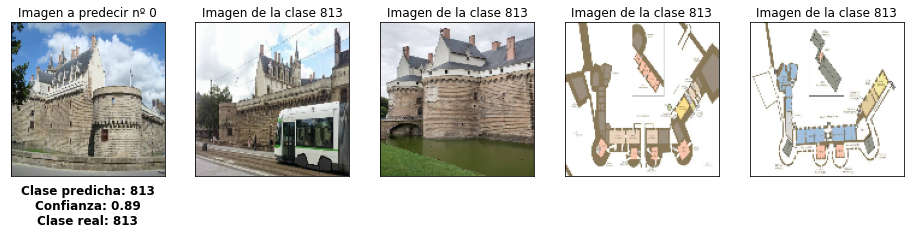

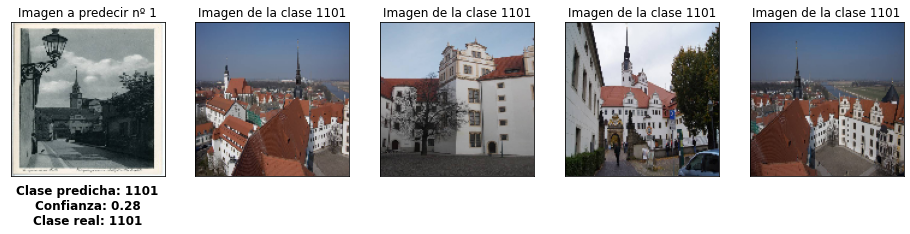

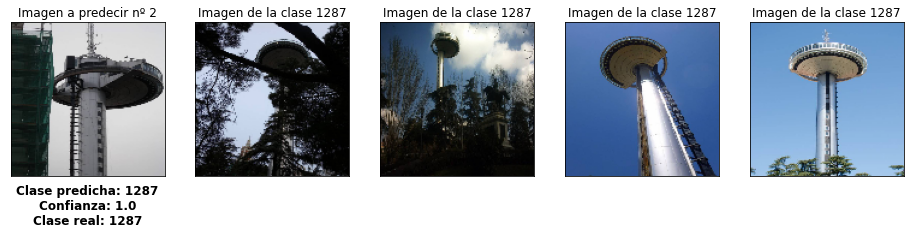

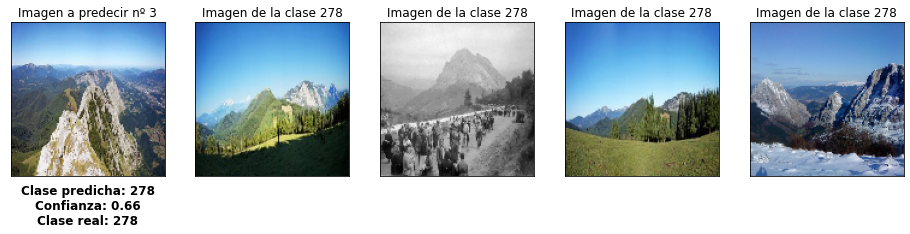

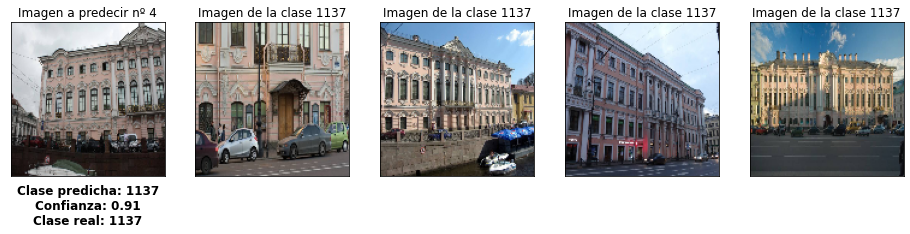

...

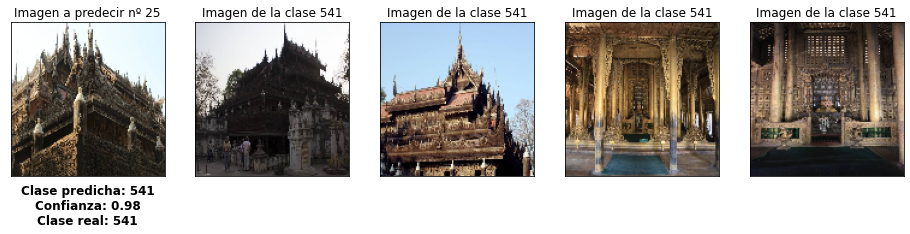

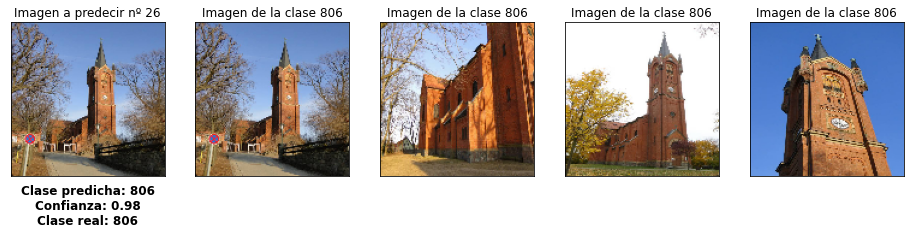

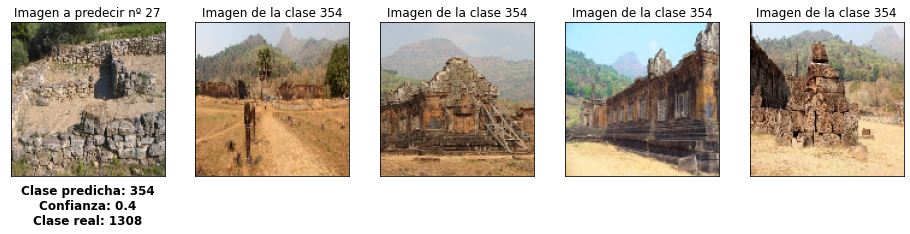

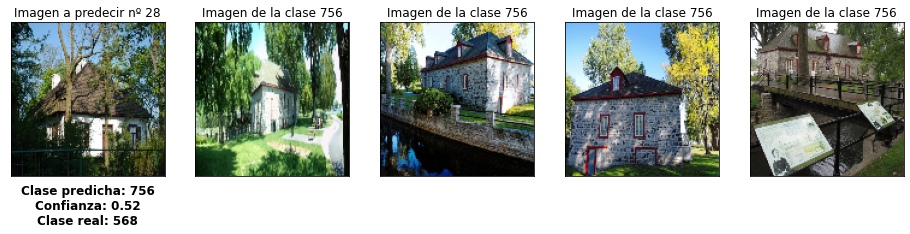

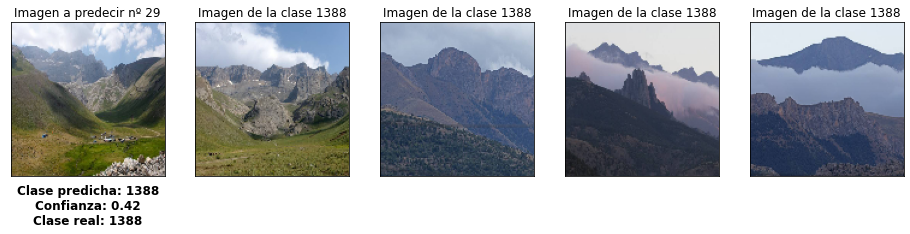

In [59]:
col = 5       #Número de columnas del subplot (teniendo en cuenta la propia imagen a predecir)
n_pred_rep = 30       #Numero de predicciones a representar

k=0
for k in range(n_pred_rep):
    plt.figure(figsize=(16,7))
    img_pred = X_test_orig[k]
    plt.subplot(1, col, 1)
    plt.xticks([])
    plt.yticks([])
    plt.title('Imagen a predecir nº '+ str(k))
    str1 = 'Clase predicha: ' + str(y_pred[k])
    str2 = 'Confianza: ' + str(confianza[k])
    str3 = 'Clase real: ' + str(y_test[k])
    plt.xlabel(str1 + '\n' + str2 + '\n' + str3, fontsize = 12, weight = 'bold')             #Para imprimir en 3 líneas distintas
    plt.imshow(img_pred)
    
    i=0
    img_clase_df = traindf[traindf['landmark_id']==y_pred[k]]            #Dataframe con imágenes de igual 'landmark_id' que la predicción
    
    for i in range(len(img_clase_df)):
        if i < (col-1): 
            img_clase_path = img_clase_df.iloc[i,2] 
            img_clase = img_read_resize(img_clase_path)
            plt.subplot(1, col, i+2)
            plt.xticks([])
            plt.yticks([])
            plt.title('Imagen de la clase '+ str(y_pred[k]))
            plt.xlabel(str())
            plt.imshow(img_clase)
        else:
            break;

&nbsp;
&nbsp;
&nbsp;

# **MATRIZ DE CONFUSIÓN**

In [60]:
clases_usadas = np.append(np.unique(y_test), np.unique(y_pred))    #Todas las clases usadas en predicción y testeo (algunas repetidas)
clases_unicas_usadas = np.unique(clases_usadas)                    #Se eliminan las repetidas y se ordenan de menor a mayor
clases_unicas_usadas

array([   1,    9,   12,   24,   27,   30,   36,   41,   43,   48,   50,
         58,   65,   72,   81,   84,   90,   99,  115,  117,  123,  124,
        134,  136,  139,  141,  149,  155,  168,  177,  185,  187,  189,
        191,  192,  202,  212,  216,  219,  223,  226,  228,  230,  232,
        242,  244,  247,  250,  259,  260,  274,  277,  278,  283,  297,
        300,  309,  316,  320,  332,  341,  344,  347,  350,  354,  355,
        357,  375,  380,  386,  389,  390,  392,  393,  394,  406,  417,
        452,  453,  454,  455,  458,  460,  467,  471,  494,  497,  504,
        510,  514,  539,  541,  543,  545,  562,  568,  577,  578,  581,
        582,  589,  596,  599,  604,  607,  610,  615,  619,  622,  624,
        629,  633,  635,  641,  643,  644,  646,  650,  656,  658,  677,
        678,  679,  683,  689,  691,  696,  699,  716,  717,  720,  734,
        736,  744,  756,  761,  764,  770,  776,  782,  790,  793,  795,
        802,  806,  813,  816,  817,  826,  835,  8

In [61]:
cm = confusion_matrix(y_test, y_pred)  #Número de filas y columnas = número de clases distintas usadas tanto en y_test como y_pred (orden menor a mayor)

df_mat_conf = pd.DataFrame(cm, columns=clases_unicas_usadas, index=clases_unicas_usadas)
df_mat_conf

,1,9,12,24,27,30,36,41,43,48,...,1453,1459,1461,1466,1468,1469,1475,1477,1491,1496
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
12,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
24,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
27,0,0,0,0,4,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1469,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1475,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,2,0,0,0
1477,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1491,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


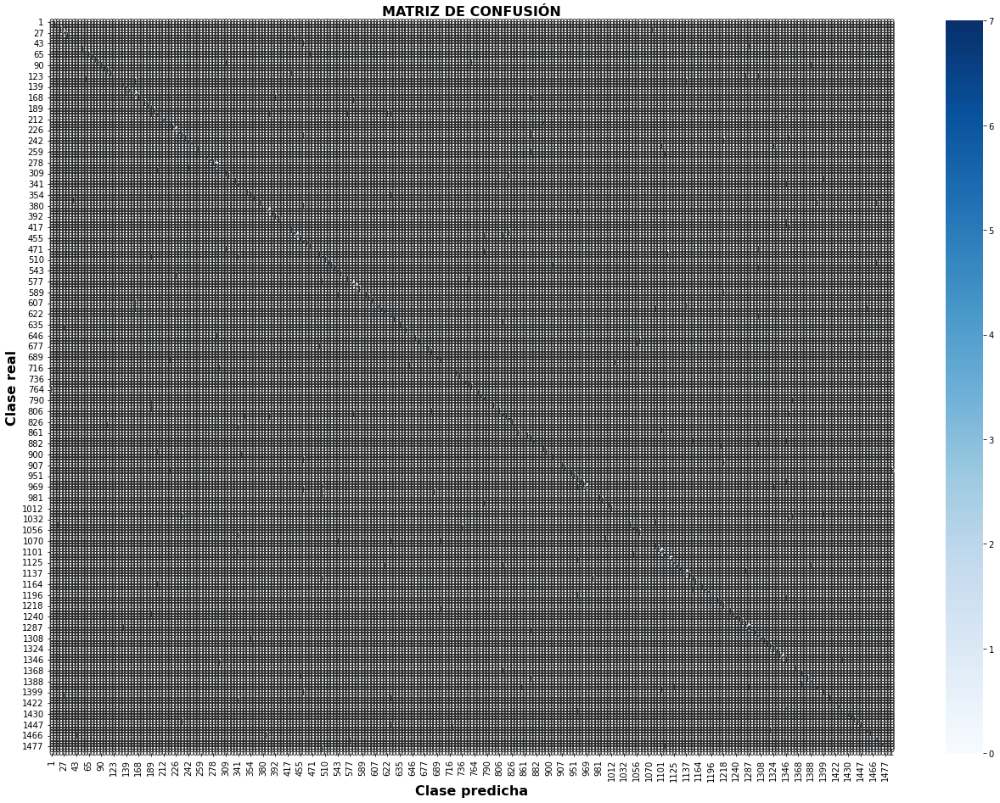

In [62]:
figure = plt.figure(figsize=(18, 13))
plt.title("MATRIZ DE CONFUSIÓN", fontsize=16, fontweight='bold')

s=sns.heatmap(df_mat_conf, annot=True, cmap='Blues', fmt="d")

plt.tight_layout()
plt.xlabel("Clase predicha", fontsize=16, fontweight='bold')
plt.ylabel("Clase real", fontsize=16, fontweight='bold')
plt.show()

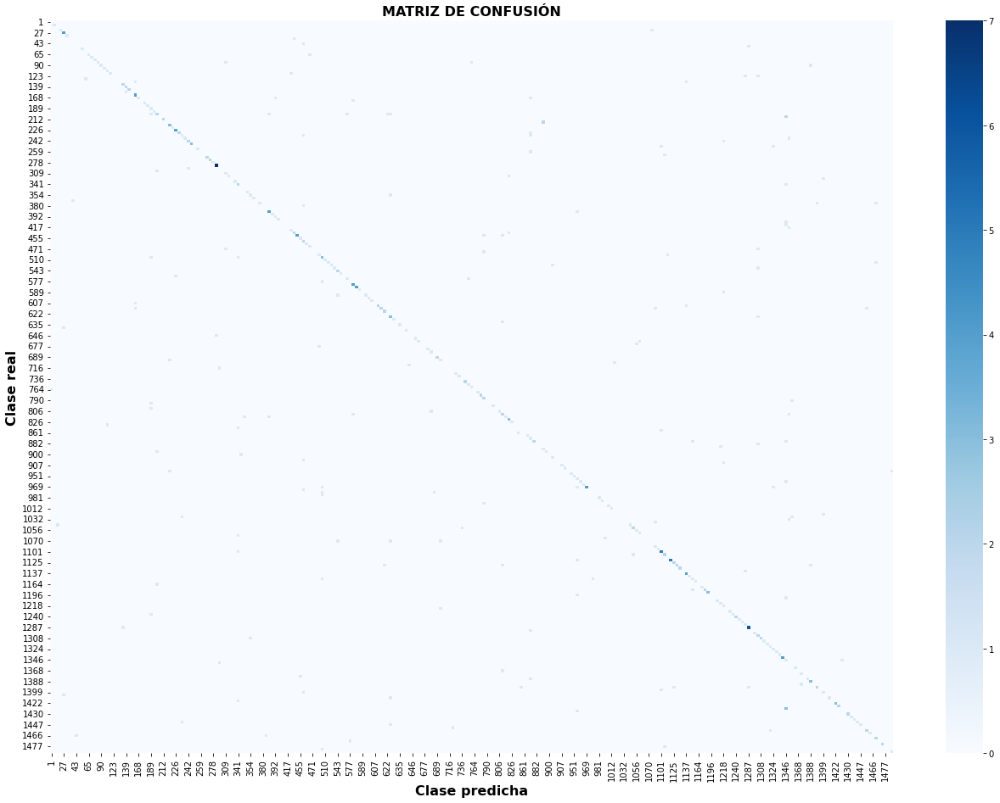

In [63]:
figure = plt.figure(figsize=(18, 13))
plt.title("MATRIZ DE CONFUSIÓN", fontsize=16, fontweight='bold')

s=sns.heatmap(df_mat_conf, annot=False, cmap='Blues', fmt="d")

plt.tight_layout()
plt.xlabel("Clase predicha", fontsize=16, fontweight='bold')
plt.ylabel("Clase real", fontsize=16, fontweight='bold')
plt.show()

&nbsp;
&nbsp;
&nbsp;

# **PREDICCIÓN DE LOS DATOS DE TESTEO de COMPETICIÓN**

### Carga del dataset de testeo y representación de su contenido

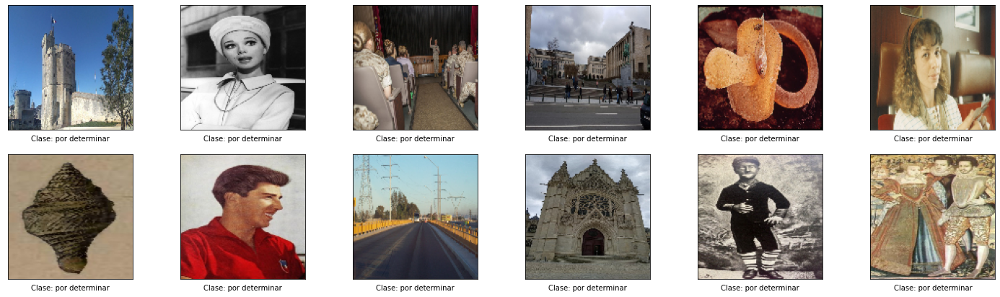

In [64]:
mainpath_test = '../input/landmark-recognition-2021/test'

sample_subm = pd.read_csv('../input/landmark-recognition-2021/sample_submission.csv')         #Leer archivo .csv con imágenes a clasificar

plt.figure(figsize=(25,7))

for i in range(12):
    img_id = sample_subm['id'][i]
    img_path = os.path.join(mainpath_test, img_id[0], img_id[1], img_id[2], img_id + '.jpg')
    img = img_read_resize(img_path)  #Se usa la función previamente definida para lograr el mismo tamaño que las imágenes de entrenamiento
    plt.subplot(2 , 6, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel('Clase: por determinar')
    plt.imshow(img)

### Ajuste de datos y predicción

In [65]:
X_pred = []
X_pred_copia = []
confianza = []

#Se rellena una lista con las imágenes de testeo redimensionadas que se vayan a predecir

elem_a_predecir = 30

for i in range(elem_a_predecir): 
    img_id = sample_subm['id'][i]
    img_path = os.path.join(mainpath_test, img_id[0], img_id[1], img_id[2], img_id + '.jpg')
    img = img_read_resize(img_path)               #Se usa la función previamente definida para lograr el mismo tamaño que las imágenes de entrenamiento
    X_pred.append(img)                        

X_pred_copia = X_pred                            #Copia de las imágenes de testeo redimensionadas y sin normalizar
X_pred = np.array(X_pred)                        #/255   #Normalización de las imágenes de testeo redimensionadas

X_pred = preprocess_input(X_pred)

predic = model.predict(X_pred, verbose=1)       # batch_size=None,        #Se realiza la predicción

1/1 [==============================] - 0s 177ms/step


In [66]:
sample_subm.head()      #Archivo .csv antes de introducir resultados

,id,landmarks
0,00084cdf8f600d00,137790 0.1
1,000b15b043eb8cf0,137790 0.1
2,0011a52f9b948fd2,137790 0.1
3,00141b8a5a729084,137790 0.1
4,0018aa4b92532b77,137790 0.1


In [67]:
y_pred = []

for i in range(len(predic)):
    y_pred.append(np.argmax(predic[i]))                #Clase (landmark_id) con mayor probabilidad
    confianza.append(predic[i][y_pred[i]].round(2))    #Probabilidad de la clase con mayor probabilidad
    
y_pred = LE.inverse_transform(y_pred)
    
for i in range(len(predic)):
    sample_subm['landmarks'][i] = str(y_pred[i]) +' '+ str(confianza[i])       #Se añaden los resultados al archivo .csv

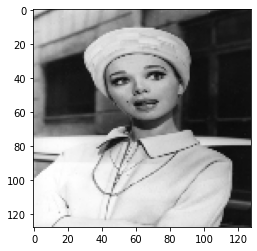

In [68]:
plt.imshow(X_pred_copia[1])

In [69]:
sample_subm.head()         #Archivo .csv después de introducir los resultados

,id,landmarks
0,00084cdf8f600d00,1302 0.64
1,000b15b043eb8cf0,1085 0.58
2,0011a52f9b948fd2,952 0.91
3,00141b8a5a729084,543 0.66
4,0018aa4b92532b77,689 0.59


### Representación visual de los resultados

In [70]:
#Leer de nuevo el dataset de entrenamiento pues se eliminó de la memoria
traindf = load_traindf()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


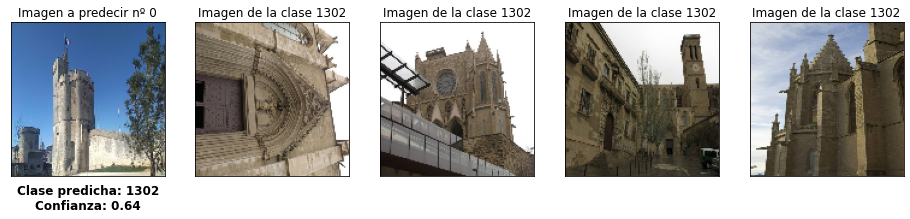

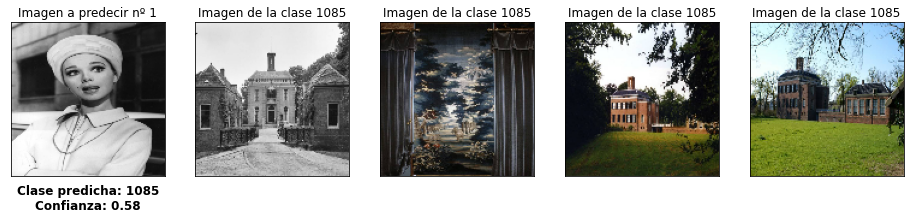

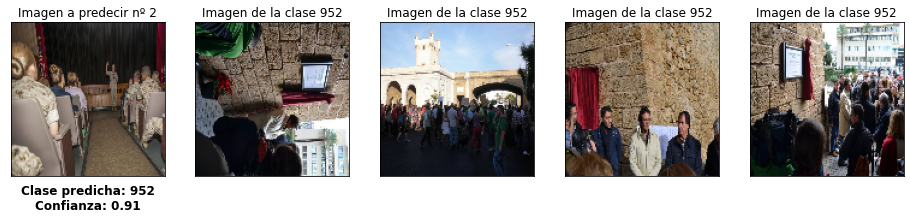

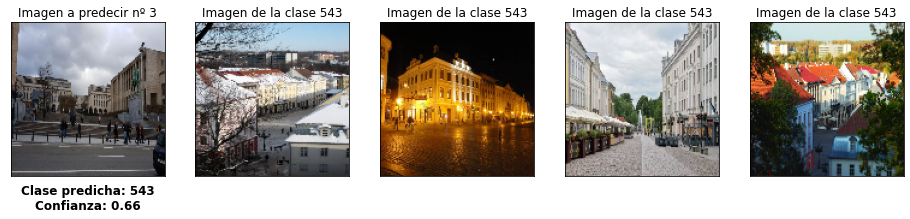

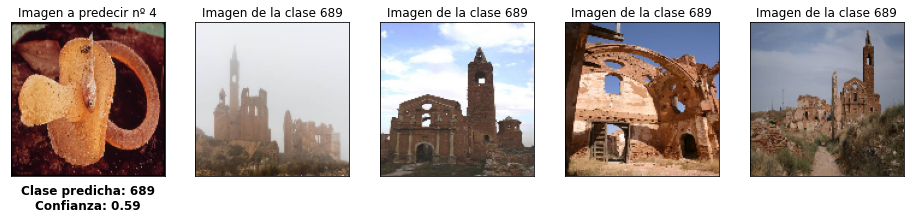

...

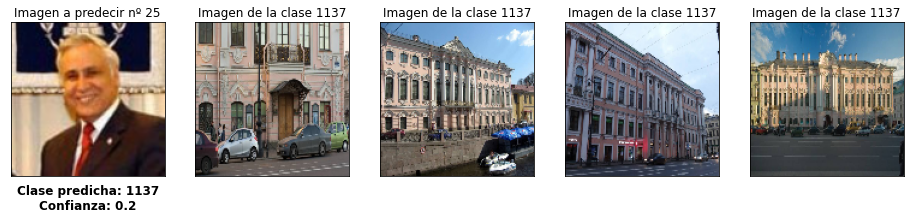

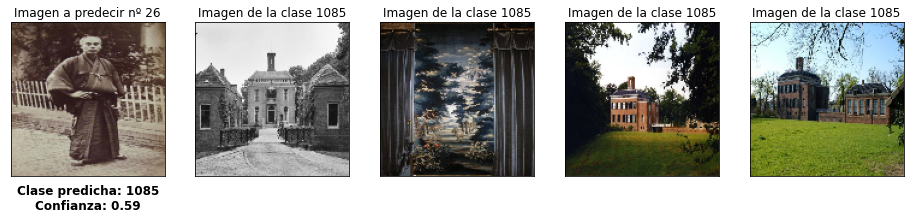

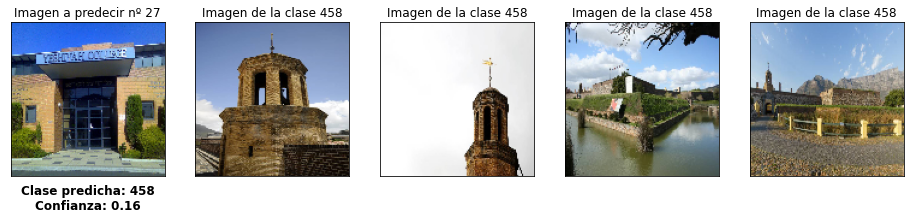

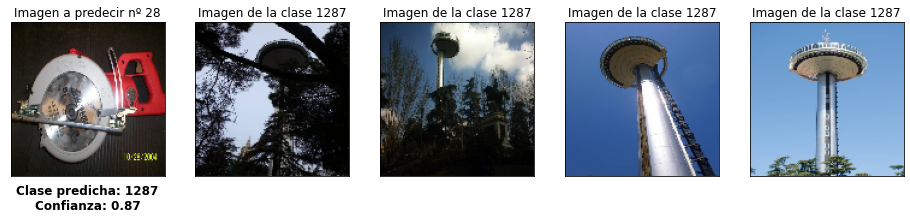

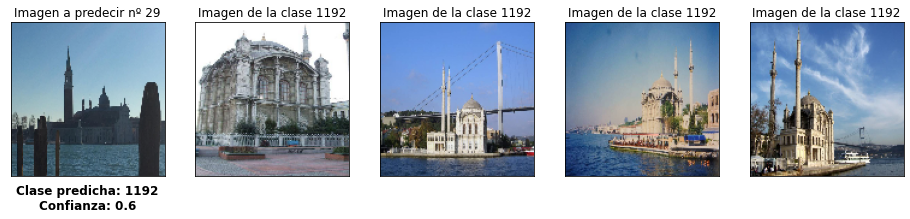

In [71]:
col = 5       #Número de columnas del subplot (teniendo en cuenta la propia imagen a predecir)

k=0
for k in range(elem_a_predecir):
    plt.figure(figsize=(16,7))
    img_pred = X_pred_copia[k]      #Cualquier imagen que se predijo anteriormente (ya está redimensionada)
    plt.subplot(1, col, 1)
    plt.xticks([])
    plt.yticks([])
    plt.title('Imagen a predecir nº '+ str(k))
    str1 = 'Clase predicha: ' + str(y_pred[k]) 
    str2 = 'Confianza: ' + str(confianza[k])
    plt.xlabel(str1 + '\n' + str2, fontsize = 12, weight = 'bold')             #Para imprimir en 2 líneas distintas
    plt.imshow(img_pred)
    
    i=0
    img_clase_df = traindf[traindf['landmark_id']==y_pred[k]]            #Dataframe con imágenes de igual 'landmark_id' que la predicción
    
    for i in range(len(img_clase_df)):
        if i < (col-1): 
            img_clase_path = img_clase_df.iloc[i,2] 
            img_clase = img_read_resize(img_clase_path)
            plt.subplot(1, col, i+2)
            plt.xticks([])
            plt.yticks([])
            plt.title('Imagen de la clase '+ str(y_pred[k]))
            plt.xlabel(str())
            plt.imshow(img_clase)
        else:
            break;